In [1]:
import sys
from pathlib import Path

import matplotlib.font_manager as fm
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
from skimage import exposure

fontprops = fm.FontProperties(size=34)
import math

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
# Import path
module_path = str(Path.cwd().parents[0])
if module_path not in sys.path:
    sys.path.append(module_path)

module_path = str(Path.cwd().parents[0] / "src")
if module_path not in sys.path:
    sys.path.append(module_path)

In [4]:
import my_io as io
from config import *

In [5]:
datasets = sorted([str(f) for f in data_raw.iterdir() if f.is_dir()])
datasets = [name.split("\\")[-1] for name in datasets]
print(datasets)

['DT1', 'DT2', 'DT3', 'DT4', 'DT5', 'DT6', 'NT1', 'NT2', 'NT3', 'NT4', 'NT5', 'NT6']


In [46]:
dataset = datasets[2]

In [47]:
io.create_folder("clusters", data_figure)

Folder is already there


WindowsPath('Y:/coskun-lab/Thomas/SpatialViz/figures/clusters')

# Read image 

In [48]:
imgs, markers = io.read_img(dataset, data_raw)

In [49]:
df_cluster = pd.read_csv(data_cluster / (dataset + "_cluster.csv"))
df_cluster.set_index("Marker", inplace=True)

In [50]:
labels = df_cluster.loc[markers]["Cluster"].values.tolist()
n_clusters = len(np.unique(labels))

# Cluster representation

In [51]:
# Generate cluster image representation
img_cluster = {}
for i in range(n_clusters):
    avg_imgs = []
    for k, label in enumerate(labels):
        if label == i:
            avg_imgs.append(imgs[k])
    arr = np.array(np.mean(avg_imgs, axis=(0)), dtype=np.uint8)
    img_cluster[i] = arr

# Stack all cluster representation together
data = np.stack(img_cluster.values(), axis=2)

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\IPython\core\interactiveshell.py:3347: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  if (await self.run_code(code, result,  async_=asy)):


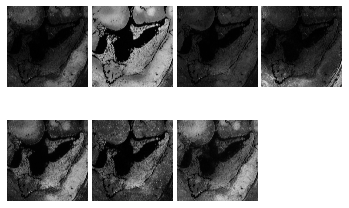

In [52]:
# Show cluster representation in black and white
fig, axs = plt.subplots(2, math.ceil(n_clusters / 2))
axs = axs.flatten()
for idx, img in enumerate(img_cluster.values()):
    axs[idx].imshow(img, cmap="gray")
for ax in axs:
    ax.axis("off")
    ax.set_aspect("equal")

fig.subplots_adjust(wspace=0.05, hspace=0.1)

In [53]:
# Extract intensity range of cluster representation
int_max = np.max(np.array(list(img_cluster.values())), axis=(1, 2))
int_range = [[0, 0] for i in range(8)]
for idx, level in enumerate(int_max):
    int_range[idx] = [0, level]
int_range

[[0, 255], [0, 255], [0, 255], [0, 255], [0, 255], [0, 255], [0, 255], [0, 0]]

In [54]:
vals = np.linspace(0, 1, n_clusters)
np.random.seed(0)
np.random.shuffle(vals)
my_color = plt.cm.gist_rainbow(vals)

In [55]:
# Useful functions

DEFAULT_CHANNELS = [i for i in range(1, n_clusters + 1)]
RGB_MAP = {
    i: {"rgb": my_color[i - 1][:3] * 255, "range": int_range[i - 1]}
    for i in DEFAULT_CHANNELS
}

# RGB_MAP = {
#     4: {
#         'rgb': np.array([255,0,0]),
#         'range': [0, 255]
#     },
#     1: {
#         'rgb': np.array([0,255,0]),
#         'range': [0, 150]
#     },
#     3: {
#         'rgb': np.array([0,0,255]),
#         'range': [0, 255]
#     },
#     6: {
#         'rgb': np.array([102,205,170]),
#         'range': [0, 255]
#     },
#     2: {
#         'rgb': np.array([253, 164, 0]),
#         'range': [0, 255]
#     },
#     5: {
#         'rgb': np.array([75,0,130]),
#         'range': [0, 100]
#     }
#     ,7: {
#         'rgb': np.array([255, 21, 240]),
#         'range': [0, 255]
#     }
#     ,8: {
#         'rgb': np.array([255, 255, 100]),
#         'range': [0, 255]
#     }
# }


def convert_to_rgb(t, channels=DEFAULT_CHANNELS, vmax=255, rgb_map=RGB_MAP):
    """
    Converts and returns the image data as RGB image
    Parameters
    ----------
    t : np.ndarray
        original image data
    channels : list of int
        channels to include
    vmax : int
        the max value used for scaling
    rgb_map : dict
        the color mapping for each channel
        See rxrx.io.RGB_MAP to see what the defaults are.
    Returns
    -------
    np.ndarray the image data of the site as RGB channels
    """
    dim1, dim2, _ = t.shape
    colored_channels = []
    for i, channel in enumerate(channels):
        x = (t[:, :, channel - 1] / vmax) / (
            (rgb_map[channel]["range"][1] - rgb_map[channel]["range"][0]) / 255
        ) + rgb_map[channel]["range"][0] / 255
        x = np.where(x > 1.0, 1.0, x)
        x_rgb = np.array(
            np.outer(x, rgb_map[channel]["rgb"]).reshape(dim1, dim2, 3), dtype=int
        )
        colored_channels.append(x_rgb)
    im = np.array(np.array(colored_channels).sum(axis=0), dtype=int)
    im = np.where(im > 255, 255, im)
    im = im.astype(np.uint8)
    return im


def one_channel(t, channel, vmax=255, rgb_map=RGB_MAP):
    """
    Converts and returns the image data as RGB image
    Parameters
    ----------
    t : np.ndarray
        original image data
    channels : list of int
        channels to include
    vmax : int
        the max value used for scaling
    rgb_map : dict
        the color mapping for each channel
        See rxrx.io.RGB_MAP to see what the defaults are.
    Returns
    -------
    np.ndarray the image data of the site as RGB channels
    """
    dim1, dim2, _ = t.shape
    colored_channels = []
    x = (t[:, :, 0] / vmax) / (
        (rgb_map[channel]["range"][1] - rgb_map[channel]["range"][0]) / 255
    ) + rgb_map[channel]["range"][0] / 255
    x = np.where(x > 1.0, 1.0, x)
    x_rgb = np.array(
        np.outer(x, rgb_map[channel]["rgb"]).reshape(dim1, dim2, 3), dtype=int
    )
    colored_channels.append(x_rgb)
    im = np.array(np.array(colored_channels).sum(axis=0), dtype=int)
    im = np.where(im > 255, 255, im)
    im = im.astype(np.uint8)
    return im

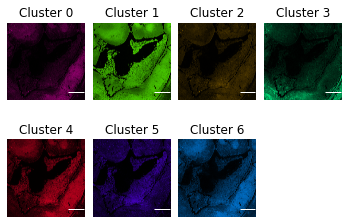

In [56]:
# Show cluster representation in color
imgs_rgb = []
for i in range(n_clusters):
    imgs_rgb.append(one_channel(img_cluster[i][:, :, None], i + 1, vmax=int_max[i]))

fig, axs = plt.subplots(2, math.ceil(n_clusters / 2))
axs = axs.flatten()
for idx, img in enumerate(imgs_rgb):
    axs[idx].imshow(img, cmap="gray")
    axs[idx].set_title(f"Cluster {idx}")
    scalebar = AnchoredSizeBar(
            axs[idx].transData,
            500,
            '',
            "lower right",
            pad=0.1,
            color="white",
            frameon=False,
            size_vertical=1,
            fontproperties=fm.FontProperties(size=6),
            )
    axs[idx].add_artist(scalebar)
for ax in axs:
    ax.axis("off")
    ax.set_aspect("equal")

fig.subplots_adjust(wspace=0.1, hspace=0.15)
fig.savefig(
    data_figure / "clusters" / f"{dataset}_cluster_rep.png", bbox_inches="tight"
)
plt.show()

In [ ]:
# Show combined for last
img_rgb = convert_to_rgb(data, vmax=255)
# # Contrast sketching
p2, p98 = np.percentile(img_rgb, (2, 98))
img_rescale = exposure.rescale_intensity(img_rgb, in_range=(p2, p98))

### All markers
fig, ax = plt.subplots(figsize=(8, 8))
ax.axis("off")
ax.imshow(img_rescale)
patches = [
    mpatches.Patch(color=RGB_MAP[i]["rgb"] / 255.0, label=i) for i in DEFAULT_CHANNELS
]
ax.legend(
    handles=patches,
    bbox_to_anchor=(0, 0),
    loc="lower left",
    borderaxespad=0.0,
    fontsize=15,
)
# Add scale bar
scalebar = AnchoredSizeBar(
    ax.transData,
    200,
    r"$200  \mu m$",
    "lower right",
    pad=0.1,
    color="white",
    frameon=False,
    size_vertical=3,
    fontproperties=fontprops,
)

ax.add_artist(scalebar)
fig.savefig(
    data_figure / "clusters" / f"{dataset}_cluster_combined.png", bbox_inches="tight"
)

In [ ]:
fig, axs = plt.subplots(5, 5, figsize=(12, 12))
axs = axs.flatten()
for i, ax in enumerate(axs):
    try:
        ax.imshow(imgs[i], cmap="gray")
        ax.axis("off")
        ax.set_title(markers[i])
        cluster = labels[i] + 1
        patches = [mpatches.Patch(color=RGB_MAP[cluster]["rgb"] / 255.0, label=cluster)]
        ax.legend(handles=patches, loc=3, borderaxespad=0.0, fontsize=10)
        # Add scale bar
        scalebar = AnchoredSizeBar(
            ax.transData,
            500,
            '',
            "lower right",
            pad=0.1,
            color="white",
            frameon=False,
            size_vertical=1,
            fontproperties=fm.FontProperties(size=6),
            )
        ax.add_artist(scalebar)
    except:
        ax.axis("off")
        ax.set_aspect("equal")

fig.subplots_adjust(wspace=0.1, hspace=0.15)
plt.show()

fig.savefig(
    data_figure / "clusters" / f"{dataset}_cluster_by_marker.png", bbox_inches="tight"
)

In [19]:
# Automatic cluster number selection
label_high_int = []
for idx, name in enumerate(markers):
    if name in ["DNA1", "DNA2", "Histone3"]:
        label_high_int.append(labels[idx])

channels = [i + 1 for i in range(n_clusters) if i not in label_high_int]

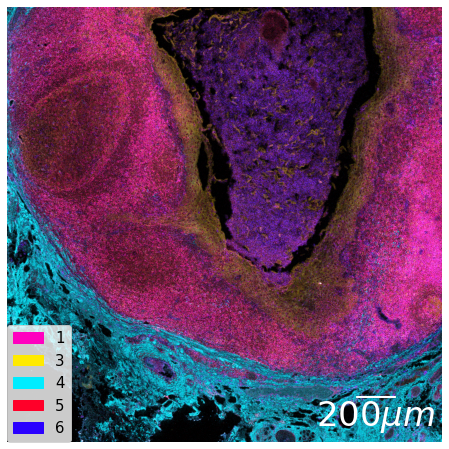

In [20]:
# selected region
fig, ax = plt.subplots(figsize=(8, 8))
ax.axis("off")
img_rgb = convert_to_rgb(data, channels=channels)

# Contrast sketching
p2, p98 = np.percentile(img_rgb, (2, 98))
img_rescale = exposure.rescale_intensity(img_rgb, in_range=(p2, p98))

ax.imshow(img_rescale)

## create patches as legend
patches = [mpatches.Patch(color=RGB_MAP[i]["rgb"] / 255.0, label=i) for i in channels]

ax.legend(
    handles=patches,
    bbox_to_anchor=(0, 0),
    loc="lower left",
    borderaxespad=0.0,
    fontsize=15,
)
# Add scale bar
scalebar = AnchoredSizeBar(
    ax.transData,
    200,
    r"$200  \mu m$",
    "lower right",
    pad=0.1,
    color="white",
    frameon=False,
    size_vertical=3,
    fontproperties=fontprops,
)

ax.add_artist(scalebar)
fig.savefig(
    data_figure / "clusters" / f"{dataset}_cluster_combined2.png", bbox_inches="tight"
)

# Loop all dataset

C:\Users\thu71\.conda\envs\spatial_signaling\lib\site-packages\IPython\core\interactiveshell.py:3347: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  if (await self.run_code(code, result,  async_=asy)):
<ipython-input-57-6f0ece822d4f>:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(2, math.ceil(n_clusters / 2))


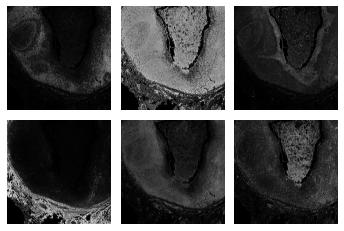

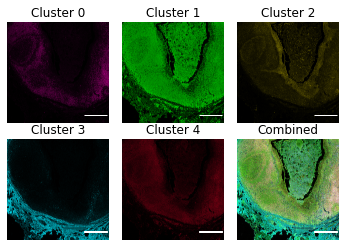

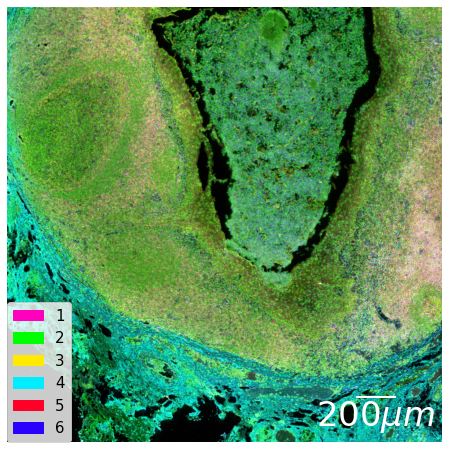

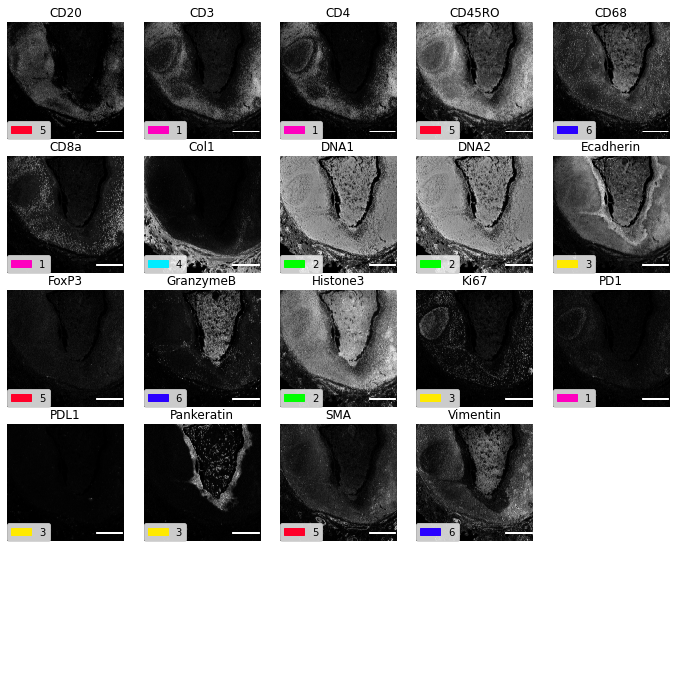

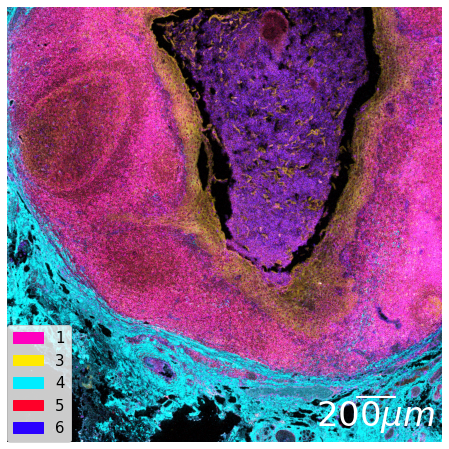

...

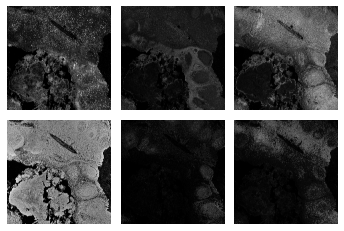

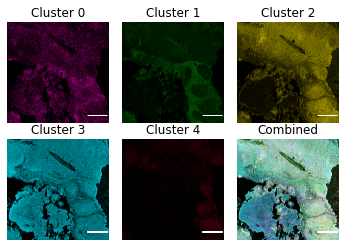

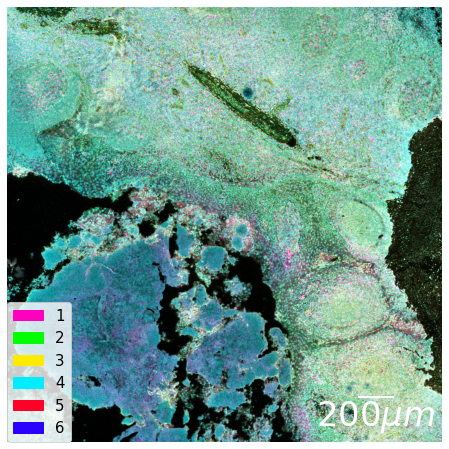

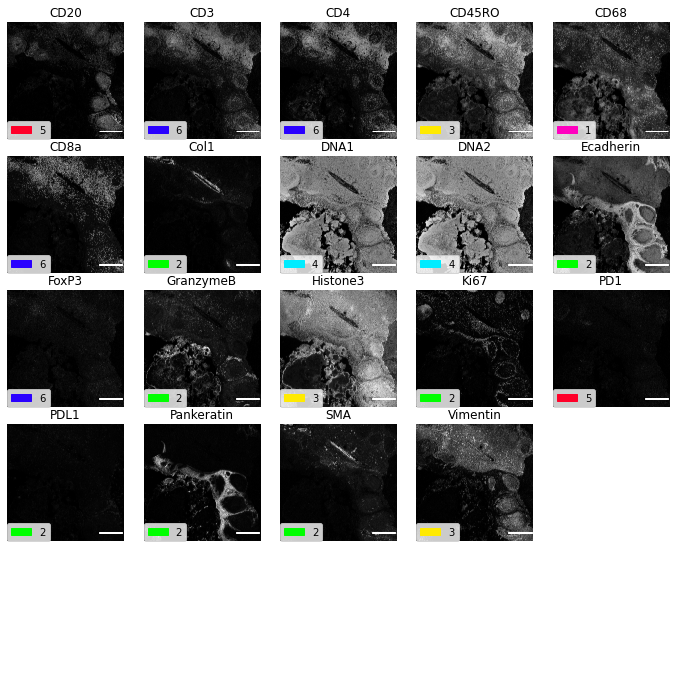

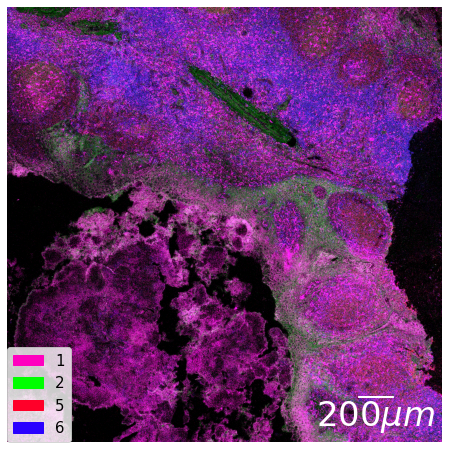

In [57]:
for dataset in datasets:
    #### Read images and cluster info
    imgs, markers = io.read_img(dataset, data_raw)
    df_cluster = pd.read_csv(data_cluster / (dataset + "_cluster.csv"))
    df_cluster.set_index("Marker", inplace=True)

    assert markers == df_cluster.index.to_list(), "Index and markers list doens't match"

    labels = df_cluster.loc[markers]["Cluster"].values.tolist()
    n_clusters = len(np.unique(labels))

    #### Cluster representation
    # Generate cluster image representation
    img_cluster = {}
    for i in range(n_clusters):
        avg_imgs = []
        for k, label in enumerate(labels):
            if label == i:
                avg_imgs.append(imgs[k])
        arr = np.array(np.mean(avg_imgs, axis=(0)), dtype=np.uint8)
        img_cluster[i] = arr

    # Stack all cluster representation together
    data = np.stack(img_cluster.values(), axis=2)

    # Show cluster representation in black and white
    fig, axs = plt.subplots(2, math.ceil(n_clusters / 2))
    axs = axs.flatten()
    for idx, img in enumerate(img_cluster.values()):
        axs[idx].imshow(img, cmap="gray")
    for ax in axs:
        ax.axis("off")
        ax.set_aspect("equal")

    fig.subplots_adjust(wspace=0.05, hspace=0.1)

    # Extract intensity range of cluster representation
    int_max = np.max(np.array(list(img_cluster.values())), axis=(1, 2))
    int_range = [[0, 255] for i in range(8)]

    # Create colormap
    vals = np.linspace(0, 1, n_clusters)
    np.random.seed(0)
    np.random.shuffle(vals)
    my_color = plt.cm.gist_rainbow(vals)

    DEFAULT_CHANNELS = [i for i in range(1, n_clusters + 1)]
    RGB_MAP = {
        i: {"rgb": my_color[i - 1][:3] * 255, "range": int_range[i - 1]}
        for i in DEFAULT_CHANNELS
    }

    # Show cluster representation in color
    imgs_rgb = []
    for i in range(n_clusters):
        imgs_rgb.append(
            one_channel(
                img_cluster[i][:, :, None], i + 1, vmax=int_max[i], rgb_map=RGB_MAP
            )
        )

    fig, axs = plt.subplots(2, math.ceil(n_clusters / 2))
    axs = axs.flatten()
    for idx, img in enumerate(imgs_rgb):
        axs[idx].imshow(img, cmap="gray")
        axs[idx].set_title(f"Cluster {idx}")
        scalebar = AnchoredSizeBar(
            axs[idx].transData,
            500,
            '',
            "lower right",
            pad=0.1,
            color="white",
            frameon=False,
            size_vertical=5,
            fontproperties=fm.FontProperties(size=6),
            )
        axs[idx].add_artist(scalebar)
    for ax in axs:
        ax.axis("off")
        ax.set_aspect("equal")
    fig.subplots_adjust(wspace=0.1, hspace=0.15)
    fig.savefig(
        data_figure / "clusters" / f"{dataset}_cluster_rep.png",
        bbox_inches="tight",
    )
    
    # Show combined for last
    img_rgb = convert_to_rgb(data, vmax=300, channels=DEFAULT_CHANNELS, rgb_map=RGB_MAP)
    # # Contrast sketching
    p2, p98 = np.percentile(img_rgb, (2, 98))
    img_rescale = exposure.rescale_intensity(img_rgb, in_range=(p2, p98))
    axs[-1].imshow(img_rescale)
    axs[-1].set_title(f"Combined")

    ### All markers
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.axis("off")
    ax.imshow(img_rescale)
    patches = [
        mpatches.Patch(color=RGB_MAP[i]["rgb"] / 255.0, label=i)
        for i in DEFAULT_CHANNELS
    ]
    ax.legend(
        handles=patches,
        bbox_to_anchor=(0, 0),
        loc="lower left",
        borderaxespad=0.0,
        fontsize=15,
    )
    # Add scale bar
    scalebar = AnchoredSizeBar(
        ax.transData,
        200,
        r"$200  \mu m$",
        "lower right",
        pad=0.1,
        color="white",
        frameon=False,
        size_vertical=3,
        fontproperties=fontprops,
    )

    ax.add_artist(scalebar)
    fig.savefig(
        data_figure / "clusters" / f"{dataset}_cluster_combined.png",
        bbox_inches="tight",
    )

    fig, axs = plt.subplots(5, 5, figsize=(12, 12))
    axs = axs.flatten()
    for i, ax in enumerate(axs):
        try:
            ax.imshow(imgs[i], cmap="gray")
            ax.axis("off")
            ax.set_title(markers[i])
            cluster = labels[i] + 1
            patches = [
                mpatches.Patch(color=RGB_MAP[cluster]["rgb"] / 255.0, label=cluster)
            ]
            ax.legend(handles=patches, loc=3, borderaxespad=0.0, fontsize=10)
            scalebar = AnchoredSizeBar(
                    ax.transData,
                    500,
                    '',
                    "lower right",
                    pad=0.1,
                    color="white",
                    frameon=False,
                    size_vertical=5,
                    fontproperties=fm.FontProperties(size=6),
                    )
            ax.add_artist(scalebar)
        except:
            ax.axis("off")
            ax.set_aspect("equal")

    fig.subplots_adjust(wspace=0.1, hspace=0.15)
    fig.savefig(
        data_figure / "clusters" / f"{dataset}_cluster_by_marker.png",
        bbox_inches="tight",
    )

    #### Show only subset of cluster combined
    label_high_int = []
    for idx, name in enumerate(markers):
        if name in ["DNA1", "DNA2", "Histone3"]:
            label_high_int.append(labels[idx])

    # selected region
    channels = [i + 1 for i in range(n_clusters) if i not in label_high_int]
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.axis("off")
    img_rgb = convert_to_rgb(data, vmax=300, channels=channels, rgb_map=RGB_MAP)

    # Contrast sketching
    p2, p98 = np.percentile(img_rgb, (4, 90))
    img_rescale = exposure.rescale_intensity(img_rgb, in_range=(p2, p98))

    ax.imshow(img_rescale)

    ## create patches as legend
    patches = [
        mpatches.Patch(color=RGB_MAP[i]["rgb"] / 255.0, label=i) for i in channels
    ]

    ax.legend(
        handles=patches,
        bbox_to_anchor=(0, 0),
        loc="lower left",
        borderaxespad=0.0,
        fontsize=15,
    )
    # Add scale bar
    scalebar = AnchoredSizeBar(
        ax.transData,
        200,
        r"$200  \mu m$",
        "lower right",
        pad=0.1,
        color="white",
        frameon=False,
        size_vertical=3,
        fontproperties=fontprops,
    )

    ax.add_artist(scalebar)
    fig.savefig(
        data_figure / "clusters" / f"{dataset}_cluster_combined2.png",
        bbox_inches="tight",
    )